Note: Recommend not rerunning this, as it will take a while to generate and train the 20 models. We provide the already trained models if you are interested in exploring them further!

In [1]:
# import statements 

import os
#disable CUDA

import platform
import random
import shutil
import sys

import math
import itertools
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import seaborn as sns
import sklearn.metrics
import tensorflow as tf
from tensorflow.python.saved_model import tag_constants
from tqdm import tqdm_notebook as tqdm
import keras

# some visualization imports
from keras import activations

# various imports for the keras model
from keras.layers.core import Permute
from keras import backend as K
from keras.engine.topology import Layer
import keras as keras
from keras.callbacks import TensorBoard
from keras import metrics as metrics
from keras.models import Sequential, Model
from keras.layers import Dense, Dropout, Activation, Flatten, Input, Conv1D, Concatenate
from keras.optimizers import SGD
from keras.regularizers import l2

# evaluate performance w/ on and off regression separately 
from scipy.stats import pearsonr, spearmanr 

# imports for the grid search and kfold CV
from sklearn.model_selection import KFold, train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve, average_precision_score

# data one-hot encoding imports
from pysster.One_Hot_Encoder import One_Hot_Encoder
from sklearn import preprocessing
from keras.utils import to_categorical
import logomaker as lm

Using TensorFlow backend.


# Part 1: Load in data. Filter and sample to avoid bias from expiremental errors. 

In [2]:
data_dir = '../../data/'
file_name = 'newQC_toehold_data.csv'
data_df = pd.read_csv(data_dir + file_name,sep=',')
data_df.head(3)

,off_id,on_id,source_sequence,sequence_id,pre_seq,promoter,trigger,loop1,switch,loop2,...,stem2,linker,post_linker,on_value,off_value,onoff_value,on_qc,off_qc,onoff_qc,switch_sequence
0,AACCAAACACACAAACGCACAAAAAAAAAAAAAAAAAATGGAAAAC...,AACTGTTTTCCATTTTTTTTTTTTTTTTTTAACCAAACACACAAAC...,smallpox,smallpox_tile_2626,CTCTGGGCTAACTGTCGCGC,TAATACGACTCACTATAGGG,AACTGTTTTCCATTTTTTTTTTTTTTTTTT,AACCAAACACACAAACGCAC,AAAAAAAAAAAAAAAAAATGGAAAACAGTT,AACAGAGGAGA,...,CCATTTTTT,AACCTGGCGGCAGCGCAAAAGATGCG,TAAAGGAGAA,NaN,0.333333,NaN,NaN,NaN,NaN,AAAAAAAAAAAAAAAAAATGGAAAACAGTTAACAGAGGAGAAACTG...
1,AACCAAACACACAAACGCACAAAAAAAAAAAAATGGAAAACAGTTA...,TTAGTAACTGTTTTCCATTTTTTTTTTTTTAACCAAACACACAAAC...,smallpox,smallpox_tile_2625,CTCTGGGCTAACTGTCGCGC,TAATACGACTCACTATAGGG,TTAGTAACTGTTTTCCATTTTTTTTTTTTT,AACCAAACACACAAACGCAC,AAAAAAAAAAAAATGGAAAACAGTTACTAA,AACAGAGGAGA,...,GTTTTCCAT,AACCTGGCGGCAGCGCAAAAGATGCG,TAAAGGAGAA,NaN,NaN,NaN,NaN,NaN,NaN,AAAAAAAAAAAAATGGAAAACAGTTACTAAAACAGAGGAGATTAGT...
2,AACCAAACACACAAACGCACAAAAAAAAATTACTACTATTGTTAAT...,CTAAATTAACAATAGTAGTAATTTTTTTTTAACCAAACACACAAAC...,smallpox,smallpox_tile_4951,CTCTGGGCTAACTGTCGCGC,TAATACGACTCACTATAGGG,CTAAATTAACAATAGTAGTAATTTTTTTTT,AACCAAACACACAAACGCAC,AAAAAAAAATTACTACTATTGTTAATTTAG,AACAGAGGAGA,...,CAATAGTAG,AACCTGGCGGCAGCGCAAAAGATGCG,TAAAGGAGAA,0.068295,0.000000,0.068295,2.0,1.1,1.1,AAAAAAAAATTACTACTATTGTTAATTTAGAACAGAGGAGACTAAA...


In [3]:
qc_cutoff=1.1
data_df = data_df[data_df['on_qc'] >= qc_cutoff].reset_index()
data_df = data_df[data_df['off_qc'] >= qc_cutoff].reset_index()
toehold_seqs = data_df['switch_sequence']
seq_len = len(toehold_seqs[0])
print('Number of remaining sequences: ', len(data_df))

Number of remaining sequences:  91534


Now downsample data to avoid bias.

In [4]:
on_value_bin_labels = np.arange(1000)
on_value_bins = pd.cut(data_df['on_value'], bins=1000, labels=on_value_bin_labels)
bin_floor_on = math.floor(data_df['on_value'].value_counts(bins=1000).mean())

off_value_bin_labels = np.arange(1000)
off_value_bins = pd.cut(data_df['off_value'], bins=1000, labels=off_value_bin_labels)
bin_floor_off = math.floor(data_df['off_value'].value_counts(bins=1000).mean())

In [5]:
# Going through the 1000 bin counts and preventing no more than 
# the mean number of counts in each bin, then adding all of the indicies
# of the bins to a list for the on and off values
sample_ids_on = []
for bin_label in on_value_bin_labels:
    bin_indices = on_value_bins[on_value_bins == bin_label].index
    bin_num = bin_indices.size
    if bin_num > bin_floor_on:
        sample = np.random.choice(bin_indices, size=bin_floor_on, replace=False)
    else:
        sample = bin_indices
    sample_ids_on.append(sample.tolist())  

sample_ids_off = []
for bin_label in off_value_bin_labels:
    bin_indices = off_value_bins[off_value_bins == bin_label].index
    bin_num = bin_indices.size
    if bin_num > bin_floor_off:
        sample = np.random.choice(bin_indices, size=bin_floor_off, replace=False)
    else:
        sample = bin_indices
    sample_ids_off.append(sample.tolist()) 

In [6]:
# Breaking down list of lists into one list
sample_on = itertools.chain.from_iterable(sample_ids_on)
sample_off = itertools.chain.from_iterable(sample_ids_off)

# take intersection of sample_ids_on and sample_ids_off 
sample_ids_union = set(sample_on).union(sample_off)
sub_df = data_df.loc[sample_ids_union].reset_index(drop=True)

print('New number of remaining seqs:', len(sub_df))

New number of remaining seqs: 81167


In [7]:
# update parameters to match original (in order to not break later code w/ new sampling)
data_df = sub_df
toehold_seqs = data_df['switch_sequence']

# Part 2. Transform Data. One-hot encode sequences and extact target on and off values.

In [8]:
alph_letters = sorted('ATCG')
alph = list(alph_letters)

# one-hot encode
one = One_Hot_Encoder(alph_letters)
def _get_one_hot_encoding(seq):
    one_hot_seq = one.encode(seq)                         
    return one_hot_seq

# now convert the data into one_hot_encoding 
input_col_name = 'switch_sequence'
X = np.stack([_get_one_hot_encoding(s) for s in toehold_seqs]).astype(np.float32)

# reformat for CNN if needed
print('input shape: ', X.shape)
alph_len = len(alph)
seq_len = len(data_df[input_col_name][0])
X = X.reshape(X.shape[0], seq_len, alph_len).astype('float32')
print('modified shape: ', X.shape)

y_on = np.array(data_df['on_value'].astype(np.float32))
y_off = np.array(data_df['off_value'].astype(np.float32))

# combine on and off values
y = np.transpose(np.array([y_on,y_off,]))
print('target shape: ', y.shape)

input shape:  (81167, 59, 4)
modified shape:  (81167, 59, 4)
target shape:  (81167, 2)


# Part 3. Set-up framework for model. Ensure needed parameters can be varied.

In [9]:
from keras import optimizers
def twoheaded_conv1d(conv_layer_parameters, hidden_layers, dropout_rate = 0.2, reg_coeff = 0.0001,learning_rate=0.001, num_features = 59, num_channels = 4): 
    # num_features = seq length, num_channels = alphabet size (i.e. # nucleotides)
    X_in = Input(shape=(num_features,num_channels),dtype='float32')
    prior_layer = X_in 
    for idx, (kernel_width, num_filters) in enumerate(conv_layer_parameters):
        conv_layer = Conv1D(filters=num_filters, kernel_size=kernel_width, padding='same', name='conv_'+str(idx))(prior_layer) # mimic a kmer
        prior_layer = conv_layer
    H = Flatten()(prior_layer)
    for idx, h in enumerate(hidden_layers): 
        H = Dropout(dropout_rate)(H)
        H = Dense(h, activation='relu', kernel_regularizer=l2(reg_coeff),name='dense_'+str(idx))(H)
    out_on = Dense(1,activation="linear",name='on_output')(H)
    out_off = Dense(1, activation='linear', name='off_output')(H)
    model = Model(inputs=[X_in], outputs=[out_on, out_off])
    opt = optimizers.adam(lr = learning_rate)
    model.compile(loss={'on_output': 'mse', 'off_output': 'mse'},optimizer=opt,metrics=['mse'])
    return model


# Part 4. Define desired model features. Build sample model to view architecture.

In [10]:
# [(kernel_width_layer1, #filters_layer1), (kernel_width_layer2, #filters_layer2), ...]
conv_layer_parameters = [(5,10), (3,5)]
hidden_layer_choices = {5: (150, 60, 15), 10: (300, 100, 30), 15: (400,150, 30),}
# dependent on # filters in final convolutional layer before MLP 
hidden_layers = hidden_layer_choices[5]
dropout_rate = 0.1
l2_reg_coeff = 0.0001
learning_rate = 0.0005 

# build sample master model (to be trained completely later)
sample_model = twoheaded_conv1d(conv_layer_parameters=conv_layer_parameters, hidden_layers= hidden_layers, 
                         dropout_rate=dropout_rate, reg_coeff=l2_reg_coeff, 
                         learning_rate= learning_rate)

# print model architecture 
sample_model.summary()

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 59, 4)        0                                            
__________________________________________________________________________________________________
conv_0 (Conv1D)                 (None, 59, 10)       210         input_1[0][0]                    
__________________________________________________________________________________________________
conv_1 (Conv1D)                 (None, 59, 5)        155         conv_0[0][0]                     
__________________________________________________________________________________________________
flatten_1 (Flatten)  

# Part 5. Make function to train a model

In [11]:
def train_one_model(string_name_to_save):

    # train on more of the data (no testing - use metrics from kfold as final metrics)
    # have small held-out data for 

    # split data again for validation set (to be used w/ early stopping)
    train_size = 0.85
    X_train, X_val, y_train, y_val = train_test_split(X, y, train_size = train_size, test_size = 1-train_size)

    # define parameters for training 
    num_epochs = 150
    patience = int(num_epochs * .1)
    
    # build model
    model = twoheaded_conv1d(conv_layer_parameters=conv_layer_parameters, hidden_layers= hidden_layers, 
                         dropout_rate=dropout_rate, reg_coeff=l2_reg_coeff, 
                         learning_rate= learning_rate)
    
    # train model
    early_stopping = keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0.0, patience=patience, verbose=2, mode='auto')
    model.fit(X_train, [y_train[:,0], y_train[:,1]],epochs=num_epochs, batch_size=128,verbose=2, validation_data=(X_val, [y_val[:,0], y_val[:,1]]), callbacks=[early_stopping])

    # save model (architecture + weights) 
    model.save('twenty_models/' + string_name_to_save + '.h5')
    model.save_weights('twenty_models/' + string_name_to_save + '_weights.h5')
    
    return model
    

# Part 6: Make function to analyze filter in model

In [12]:
def analyze_filters_in_model(model, string_name_to_save):
    # extract first 1d conv layer
    conv1 = model.layers[1]
    # get filter weights and bias weights
    fw, bw = conv1.get_weights()
    print('filter weight matrix shape: ', fw.shape)

    logos=[]
    fig, axs = plt.subplots(5,2, figsize=(20, 25), dpi = 300)
    fig.subplots_adjust(hspace = 0.8, wspace=.5)

    alph_letters = sorted('AUCG')
    alph = list(alph_letters)

    axs = axs.ravel()

    for filt_idx in range(fw.shape[2]): 
        filt_weight_df = pd.DataFrame(fw[:,:,filt_idx], columns=alph)
        current_name = string_name_to_save + '_index_' + str(filt_idx)
        filt_weight_df.to_csv('ensemble_models/csv_files/' + current_name + '_filter_matrix.csv')
        logo = lm.Logo(filt_weight_df,ax=axs[filt_idx], center_values = True, vpad = 0, fade_below = 0.5, shade_below = 0.4, show_spines = True)
        axs[filt_idx].spines['right'].set_visible(True)
        axs[filt_idx].spines['top'].set_visible(True)
        axs[filt_idx].set_xticklabels([0, 1, 2, 3, 4, 5], fontsize = 25)

        ylabels = axs[filt_idx].get_yticks()
        ytickmax = max(ylabels)
        ytickmin = min(ylabels)

        axs[filt_idx].set_yticks([-0.5, -0.25, 0, 0.25, 0.5])
        axs[filt_idx].tick_params(length = 10, width = 1)
        axs[filt_idx].set_yticklabels([-0.5, -0.25, 0, 0.25, 0.5], fontsize = 25)   

        axs[filt_idx].set_xlabel('Position', fontsize = 25)
        axs[filt_idx].set_ylabel('Filter Weight', fontsize = 25)
        axs[filt_idx].set_title('Filter ' + str(filt_idx + 1), fontsize = 35)
        logos.append(logo)
        #plt.imshow(logo)
    plt.savefig('ensemble_models/sequence_logos/' + string_name_to_save + '_seq_logo_figure.svg', format = 'svg')

# Part 7: Loop thru num_ensembl_models to get filters for each

Instructions for updating:
Use tf.cast instead.
Train on 68991 samples, validate on 12176 samples
Epoch 1/150
 - 3s - loss: 0.1443 - on_output_loss: 0.0716 - off_output_loss: 0.0437 - on_output_mean_squared_error: 0.0716 - off_output_mean_squared_error: 0.0437 - val_loss: 0.1145 - val_on_output_loss: 0.0539 - val_off_output_loss: 0.0338 - val_on_output_mean_squared_error: 0.0539 - val_off_output_mean_squared_error: 0.0338
Epoch 2/150
 - 3s - loss: 0.1153 - on_output_loss: 0.0553 - off_output_loss: 0.0355 - on_output_mean_squared_error: 0.0553 - off_output_mean_squared_error: 0.0355 - val_loss: 0.1018 - val_on_output_loss: 0.0477 - val_off_output_loss: 0.0317 - val_on_output_mean_squared_error: 0.0477 - val_off_output_mean_squared_error: 0.0317
Epoch 3/150
 - 3s - loss: 0.1001 - on_output_loss: 0.0468 - off_output_loss: 0.0327 - on_output_mean_squared_error: 0.0468 - off_output_mean_squared_error: 0.0327 - val_loss: 0.0850 - val_on_output_loss: 0.0380 - val_off_output_loss: 0.0282 - val

Epoch 25/150
 - 3s - loss: 0.0594 - on_output_loss: 0.0300 - off_output_loss: 0.0242 - on_output_mean_squared_error: 0.0300 - off_output_mean_squared_error: 0.0242 - val_loss: 0.0583 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0233 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0233
Epoch 26/150
 - 3s - loss: 0.0590 - on_output_loss: 0.0297 - off_output_loss: 0.0241 - on_output_mean_squared_error: 0.0297 - off_output_mean_squared_error: 0.0241 - val_loss: 0.0574 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0230 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0230
Epoch 27/150
 - 3s - loss: 0.0583 - on_output_loss: 0.0293 - off_output_loss: 0.0239 - on_output_mean_squared_error: 0.0293 - off_output_mean_squared_error: 0.0239 - val_loss: 0.0574 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0230 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0230
Epoch 28/150


Epoch 50/150
 - 3s - loss: 0.0574 - on_output_loss: 0.0289 - off_output_loss: 0.0234 - on_output_mean_squared_error: 0.0289 - off_output_mean_squared_error: 0.0234 - val_loss: 0.0573 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0228 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0228
Epoch 51/150
 - 3s - loss: 0.0568 - on_output_loss: 0.0285 - off_output_loss: 0.0232 - on_output_mean_squared_error: 0.0285 - off_output_mean_squared_error: 0.0232 - val_loss: 0.0573 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0227 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0227
Epoch 52/150
 - 3s - loss: 0.0568 - on_output_loss: 0.0284 - off_output_loss: 0.0233 - on_output_mean_squared_error: 0.0284 - off_output_mean_squared_error: 0.0233 - val_loss: 0.0574 - val_on_output_loss: 0.0296 - val_off_output_loss: 0.0227 - val_on_output_mean_squared_error: 0.0296 - val_off_output_mean_squared_error: 0.0227
Epoch 53/150


Epoch 5/150
 - 3s - loss: 0.0775 - on_output_loss: 0.0354 - off_output_loss: 0.0281 - on_output_mean_squared_error: 0.0354 - off_output_mean_squared_error: 0.0281 - val_loss: 0.0718 - val_on_output_loss: 0.0317 - val_off_output_loss: 0.0272 - val_on_output_mean_squared_error: 0.0317 - val_off_output_mean_squared_error: 0.0272
Epoch 6/150
 - 3s - loss: 0.0737 - on_output_loss: 0.0342 - off_output_loss: 0.0275 - on_output_mean_squared_error: 0.0342 - off_output_mean_squared_error: 0.0275 - val_loss: 0.0695 - val_on_output_loss: 0.0317 - val_off_output_loss: 0.0268 - val_on_output_mean_squared_error: 0.0317 - val_off_output_mean_squared_error: 0.0268
Epoch 7/150
 - 3s - loss: 0.0706 - on_output_loss: 0.0335 - off_output_loss: 0.0268 - on_output_mean_squared_error: 0.0335 - off_output_mean_squared_error: 0.0268 - val_loss: 0.0679 - val_on_output_loss: 0.0316 - val_off_output_loss: 0.0267 - val_on_output_mean_squared_error: 0.0316 - val_off_output_mean_squared_error: 0.0267
Epoch 8/150
 - 3

Epoch 30/150
 - 3s - loss: 0.0583 - on_output_loss: 0.0296 - off_output_loss: 0.0236 - on_output_mean_squared_error: 0.0296 - off_output_mean_squared_error: 0.0236 - val_loss: 0.0597 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0248 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0248
Epoch 31/150
 - 3s - loss: 0.0581 - on_output_loss: 0.0293 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0293 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0589 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0244 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0244
Epoch 32/150
 - 3s - loss: 0.0581 - on_output_loss: 0.0295 - off_output_loss: 0.0236 - on_output_mean_squared_error: 0.0295 - off_output_mean_squared_error: 0.0236 - val_loss: 0.0592 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0246 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0246
Epoch 33/150


Epoch 55/150
 - 3s - loss: 0.0565 - on_output_loss: 0.0283 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0283 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0590 - val_on_output_loss: 0.0297 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0297 - val_off_output_mean_squared_error: 0.0242
Epoch 56/150
 - 3s - loss: 0.0566 - on_output_loss: 0.0285 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0285 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0604 - val_on_output_loss: 0.0302 - val_off_output_loss: 0.0250 - val_on_output_mean_squared_error: 0.0302 - val_off_output_mean_squared_error: 0.0250
Epoch 57/150
 - 3s - loss: 0.0566 - on_output_loss: 0.0285 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0285 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0596 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0245 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0245
Epoch 58/150


Epoch 80/150
 - 3s - loss: 0.0561 - on_output_loss: 0.0283 - off_output_loss: 0.0227 - on_output_mean_squared_error: 0.0283 - off_output_mean_squared_error: 0.0227 - val_loss: 0.0594 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0243
Epoch 81/150
 - 3s - loss: 0.0559 - on_output_loss: 0.0281 - off_output_loss: 0.0227 - on_output_mean_squared_error: 0.0281 - off_output_mean_squared_error: 0.0227 - val_loss: 0.0593 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0244 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0244
Epoch 82/150
 - 3s - loss: 0.0562 - on_output_loss: 0.0282 - off_output_loss: 0.0229 - on_output_mean_squared_error: 0.0282 - off_output_mean_squared_error: 0.0229 - val_loss: 0.0590 - val_on_output_loss: 0.0296 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0296 - val_off_output_mean_squared_error: 0.0243
Epoch 83/150


Epoch 12/150
 - 3s - loss: 0.0638 - on_output_loss: 0.0319 - off_output_loss: 0.0256 - on_output_mean_squared_error: 0.0319 - off_output_mean_squared_error: 0.0256 - val_loss: 0.0609 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0254 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0254
Epoch 13/150
 - 3s - loss: 0.0628 - on_output_loss: 0.0314 - off_output_loss: 0.0255 - on_output_mean_squared_error: 0.0314 - off_output_mean_squared_error: 0.0255 - val_loss: 0.0604 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0250 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0250
Epoch 14/150
 - 3s - loss: 0.0623 - on_output_loss: 0.0314 - off_output_loss: 0.0251 - on_output_mean_squared_error: 0.0314 - off_output_mean_squared_error: 0.0251 - val_loss: 0.0601 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0250 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0250
Epoch 15/150


Epoch 37/150
 - 3s - loss: 0.0579 - on_output_loss: 0.0293 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0293 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0591 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0246 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0246
Epoch 38/150
 - 3s - loss: 0.0577 - on_output_loss: 0.0293 - off_output_loss: 0.0233 - on_output_mean_squared_error: 0.0293 - off_output_mean_squared_error: 0.0233 - val_loss: 0.0587 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0243
Epoch 39/150
 - 3s - loss: 0.0575 - on_output_loss: 0.0292 - off_output_loss: 0.0232 - on_output_mean_squared_error: 0.0292 - off_output_mean_squared_error: 0.0232 - val_loss: 0.0586 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0245 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0245
Epoch 40/150


Epoch 62/150
 - 3s - loss: 0.0567 - on_output_loss: 0.0286 - off_output_loss: 0.0229 - on_output_mean_squared_error: 0.0286 - off_output_mean_squared_error: 0.0229 - val_loss: 0.0583 - val_on_output_loss: 0.0290 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0290 - val_off_output_mean_squared_error: 0.0242
Epoch 63/150
 - 3s - loss: 0.0567 - on_output_loss: 0.0285 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0285 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0588 - val_on_output_loss: 0.0292 - val_off_output_loss: 0.0245 - val_on_output_mean_squared_error: 0.0292 - val_off_output_mean_squared_error: 0.0245
Epoch 64/150
 - 3s - loss: 0.0564 - on_output_loss: 0.0284 - off_output_loss: 0.0228 - on_output_mean_squared_error: 0.0284 - off_output_mean_squared_error: 0.0228 - val_loss: 0.0583 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0241
Epoch 65/150


Epoch 11/150
 - 3s - loss: 0.0647 - on_output_loss: 0.0321 - off_output_loss: 0.0257 - on_output_mean_squared_error: 0.0321 - off_output_mean_squared_error: 0.0257 - val_loss: 0.0613 - val_on_output_loss: 0.0302 - val_off_output_loss: 0.0244 - val_on_output_mean_squared_error: 0.0302 - val_off_output_mean_squared_error: 0.0244
Epoch 12/150
 - 3s - loss: 0.0639 - on_output_loss: 0.0319 - off_output_loss: 0.0255 - on_output_mean_squared_error: 0.0319 - off_output_mean_squared_error: 0.0255 - val_loss: 0.0608 - val_on_output_loss: 0.0302 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0302 - val_off_output_mean_squared_error: 0.0243
Epoch 13/150
 - 3s - loss: 0.0631 - on_output_loss: 0.0316 - off_output_loss: 0.0254 - on_output_mean_squared_error: 0.0316 - off_output_mean_squared_error: 0.0254 - val_loss: 0.0605 - val_on_output_loss: 0.0303 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0303 - val_off_output_mean_squared_error: 0.0242
Epoch 14/150


Epoch 36/150
 - 4s - loss: 0.0576 - on_output_loss: 0.0291 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0291 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0586 - val_on_output_loss: 0.0292 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0292 - val_off_output_mean_squared_error: 0.0243
Epoch 37/150
 - 3s - loss: 0.0576 - on_output_loss: 0.0291 - off_output_loss: 0.0234 - on_output_mean_squared_error: 0.0291 - off_output_mean_squared_error: 0.0234 - val_loss: 0.0581 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0236 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0236
Epoch 38/150
 - 3s - loss: 0.0577 - on_output_loss: 0.0292 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0292 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0578 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0233 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0233
Epoch 39/150


Epoch 22/150
 - 4s - loss: 0.0592 - on_output_loss: 0.0299 - off_output_loss: 0.0242 - on_output_mean_squared_error: 0.0299 - off_output_mean_squared_error: 0.0242 - val_loss: 0.0596 - val_on_output_loss: 0.0306 - val_off_output_loss: 0.0238 - val_on_output_mean_squared_error: 0.0306 - val_off_output_mean_squared_error: 0.0238
Epoch 23/150
 - 3s - loss: 0.0593 - on_output_loss: 0.0299 - off_output_loss: 0.0242 - on_output_mean_squared_error: 0.0299 - off_output_mean_squared_error: 0.0242 - val_loss: 0.0597 - val_on_output_loss: 0.0306 - val_off_output_loss: 0.0240 - val_on_output_mean_squared_error: 0.0306 - val_off_output_mean_squared_error: 0.0240
Epoch 24/150
 - 3s - loss: 0.0590 - on_output_loss: 0.0299 - off_output_loss: 0.0241 - on_output_mean_squared_error: 0.0299 - off_output_mean_squared_error: 0.0241 - val_loss: 0.0601 - val_on_output_loss: 0.0306 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0306 - val_off_output_mean_squared_error: 0.0243
Epoch 25/150


Epoch 47/150
 - 3s - loss: 0.0571 - on_output_loss: 0.0288 - off_output_loss: 0.0232 - on_output_mean_squared_error: 0.0288 - off_output_mean_squared_error: 0.0232 - val_loss: 0.0592 - val_on_output_loss: 0.0303 - val_off_output_loss: 0.0238 - val_on_output_mean_squared_error: 0.0303 - val_off_output_mean_squared_error: 0.0238
Epoch 48/150
 - 3s - loss: 0.0569 - on_output_loss: 0.0287 - off_output_loss: 0.0231 - on_output_mean_squared_error: 0.0287 - off_output_mean_squared_error: 0.0231 - val_loss: 0.0598 - val_on_output_loss: 0.0304 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0304 - val_off_output_mean_squared_error: 0.0243
Epoch 49/150
 - 3s - loss: 0.0570 - on_output_loss: 0.0287 - off_output_loss: 0.0231 - on_output_mean_squared_error: 0.0287 - off_output_mean_squared_error: 0.0231 - val_loss: 0.0595 - val_on_output_loss: 0.0306 - val_off_output_loss: 0.0238 - val_on_output_mean_squared_error: 0.0306 - val_off_output_mean_squared_error: 0.0238
Epoch 50/150


Epoch 7/150
 - 3s - loss: 0.0724 - on_output_loss: 0.0341 - off_output_loss: 0.0274 - on_output_mean_squared_error: 0.0341 - off_output_mean_squared_error: 0.0274 - val_loss: 0.0662 - val_on_output_loss: 0.0304 - val_off_output_loss: 0.0258 - val_on_output_mean_squared_error: 0.0304 - val_off_output_mean_squared_error: 0.0258
Epoch 8/150
 - 4s - loss: 0.0698 - on_output_loss: 0.0335 - off_output_loss: 0.0269 - on_output_mean_squared_error: 0.0335 - off_output_mean_squared_error: 0.0269 - val_loss: 0.0649 - val_on_output_loss: 0.0302 - val_off_output_loss: 0.0258 - val_on_output_mean_squared_error: 0.0302 - val_off_output_mean_squared_error: 0.0258
Epoch 9/150
 - 4s - loss: 0.0680 - on_output_loss: 0.0330 - off_output_loss: 0.0267 - on_output_mean_squared_error: 0.0330 - off_output_mean_squared_error: 0.0267 - val_loss: 0.0635 - val_on_output_loss: 0.0302 - val_off_output_loss: 0.0254 - val_on_output_mean_squared_error: 0.0302 - val_off_output_mean_squared_error: 0.0254
Epoch 10/150
 - 

Epoch 32/150
 - 3s - loss: 0.0586 - on_output_loss: 0.0298 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0298 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0581 - val_on_output_loss: 0.0290 - val_off_output_loss: 0.0239 - val_on_output_mean_squared_error: 0.0290 - val_off_output_mean_squared_error: 0.0239
Epoch 33/150
 - 3s - loss: 0.0586 - on_output_loss: 0.0299 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0299 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0588 - val_on_output_loss: 0.0297 - val_off_output_loss: 0.0239 - val_on_output_mean_squared_error: 0.0297 - val_off_output_mean_squared_error: 0.0239
Epoch 34/150
 - 3s - loss: 0.0583 - on_output_loss: 0.0297 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0297 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0579 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0237
Epoch 35/150


Epoch 5/150
 - 3s - loss: 0.0767 - on_output_loss: 0.0356 - off_output_loss: 0.0283 - on_output_mean_squared_error: 0.0356 - off_output_mean_squared_error: 0.0283 - val_loss: 0.0711 - val_on_output_loss: 0.0328 - val_off_output_loss: 0.0264 - val_on_output_mean_squared_error: 0.0328 - val_off_output_mean_squared_error: 0.0264
Epoch 6/150
 - 3s - loss: 0.0729 - on_output_loss: 0.0343 - off_output_loss: 0.0276 - on_output_mean_squared_error: 0.0343 - off_output_mean_squared_error: 0.0276 - val_loss: 0.0683 - val_on_output_loss: 0.0319 - val_off_output_loss: 0.0262 - val_on_output_mean_squared_error: 0.0319 - val_off_output_mean_squared_error: 0.0262
Epoch 7/150
 - 3s - loss: 0.0699 - on_output_loss: 0.0334 - off_output_loss: 0.0269 - on_output_mean_squared_error: 0.0334 - off_output_mean_squared_error: 0.0269 - val_loss: 0.0667 - val_on_output_loss: 0.0316 - val_off_output_loss: 0.0261 - val_on_output_mean_squared_error: 0.0316 - val_off_output_mean_squared_error: 0.0261
Epoch 8/150
 - 3

Epoch 30/150
 - 3s - loss: 0.0584 - on_output_loss: 0.0294 - off_output_loss: 0.0238 - on_output_mean_squared_error: 0.0294 - off_output_mean_squared_error: 0.0238 - val_loss: 0.0597 - val_on_output_loss: 0.0302 - val_off_output_loss: 0.0244 - val_on_output_mean_squared_error: 0.0302 - val_off_output_mean_squared_error: 0.0244
Epoch 31/150
 - 3s - loss: 0.0582 - on_output_loss: 0.0294 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0294 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0590 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0241
Epoch 32/150
 - 3s - loss: 0.0584 - on_output_loss: 0.0296 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0296 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0590 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0241
Epoch 33/150


Epoch 3/150
 - 3s - loss: 0.0944 - on_output_loss: 0.0443 - off_output_loss: 0.0314 - on_output_mean_squared_error: 0.0443 - off_output_mean_squared_error: 0.0314 - val_loss: 0.0814 - val_on_output_loss: 0.0359 - val_off_output_loss: 0.0286 - val_on_output_mean_squared_error: 0.0359 - val_off_output_mean_squared_error: 0.0286
Epoch 4/150
 - 3s - loss: 0.0830 - on_output_loss: 0.0383 - off_output_loss: 0.0292 - on_output_mean_squared_error: 0.0383 - off_output_mean_squared_error: 0.0292 - val_loss: 0.0731 - val_on_output_loss: 0.0322 - val_off_output_loss: 0.0267 - val_on_output_mean_squared_error: 0.0322 - val_off_output_mean_squared_error: 0.0267
Epoch 5/150
 - 3s - loss: 0.0772 - on_output_loss: 0.0360 - off_output_loss: 0.0280 - on_output_mean_squared_error: 0.0360 - off_output_mean_squared_error: 0.0280 - val_loss: 0.0695 - val_on_output_loss: 0.0316 - val_off_output_loss: 0.0258 - val_on_output_mean_squared_error: 0.0316 - val_off_output_mean_squared_error: 0.0258
Epoch 6/150
 - 3

Epoch 28/150
 - 3s - loss: 0.0588 - on_output_loss: 0.0299 - off_output_loss: 0.0238 - on_output_mean_squared_error: 0.0299 - off_output_mean_squared_error: 0.0238 - val_loss: 0.0584 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0235 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0235
Epoch 29/150
 - 3s - loss: 0.0586 - on_output_loss: 0.0297 - off_output_loss: 0.0238 - on_output_mean_squared_error: 0.0297 - off_output_mean_squared_error: 0.0238 - val_loss: 0.0578 - val_on_output_loss: 0.0292 - val_off_output_loss: 0.0236 - val_on_output_mean_squared_error: 0.0292 - val_off_output_mean_squared_error: 0.0236
Epoch 30/150
 - 3s - loss: 0.0585 - on_output_loss: 0.0296 - off_output_loss: 0.0239 - on_output_mean_squared_error: 0.0296 - off_output_mean_squared_error: 0.0239 - val_loss: 0.0576 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0235 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0235
Epoch 31/150


Epoch 12/150
 - 3s - loss: 0.0644 - on_output_loss: 0.0321 - off_output_loss: 0.0257 - on_output_mean_squared_error: 0.0321 - off_output_mean_squared_error: 0.0257 - val_loss: 0.0600 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0243
Epoch 13/150
 - 3s - loss: 0.0637 - on_output_loss: 0.0318 - off_output_loss: 0.0255 - on_output_mean_squared_error: 0.0318 - off_output_mean_squared_error: 0.0255 - val_loss: 0.0600 - val_on_output_loss: 0.0297 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0297 - val_off_output_mean_squared_error: 0.0241
Epoch 14/150
 - 3s - loss: 0.0631 - on_output_loss: 0.0318 - off_output_loss: 0.0253 - on_output_mean_squared_error: 0.0318 - off_output_mean_squared_error: 0.0253 - val_loss: 0.0601 - val_on_output_loss: 0.0297 - val_off_output_loss: 0.0245 - val_on_output_mean_squared_error: 0.0297 - val_off_output_mean_squared_error: 0.0245
Epoch 15/150


Epoch 37/150
 - 3s - loss: 0.0582 - on_output_loss: 0.0294 - off_output_loss: 0.0236 - on_output_mean_squared_error: 0.0294 - off_output_mean_squared_error: 0.0236 - val_loss: 0.0571 - val_on_output_loss: 0.0282 - val_off_output_loss: 0.0236 - val_on_output_mean_squared_error: 0.0282 - val_off_output_mean_squared_error: 0.0236
Epoch 38/150
 - 3s - loss: 0.0581 - on_output_loss: 0.0294 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0294 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0571 - val_on_output_loss: 0.0285 - val_off_output_loss: 0.0234 - val_on_output_mean_squared_error: 0.0285 - val_off_output_mean_squared_error: 0.0234
Epoch 39/150
 - 3s - loss: 0.0578 - on_output_loss: 0.0292 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0292 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0570 - val_on_output_loss: 0.0285 - val_off_output_loss: 0.0234 - val_on_output_mean_squared_error: 0.0285 - val_off_output_mean_squared_error: 0.0234
Epoch 40/150


Epoch 62/150
 - 4s - loss: 0.0569 - on_output_loss: 0.0287 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0287 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0577 - val_on_output_loss: 0.0288 - val_off_output_loss: 0.0236 - val_on_output_mean_squared_error: 0.0288 - val_off_output_mean_squared_error: 0.0236
Epoch 63/150
 - 3s - loss: 0.0569 - on_output_loss: 0.0287 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0287 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0572 - val_on_output_loss: 0.0285 - val_off_output_loss: 0.0236 - val_on_output_mean_squared_error: 0.0285 - val_off_output_mean_squared_error: 0.0236
Epoch 64/150
 - 3s - loss: 0.0569 - on_output_loss: 0.0287 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0287 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0575 - val_on_output_loss: 0.0290 - val_off_output_loss: 0.0233 - val_on_output_mean_squared_error: 0.0290 - val_off_output_mean_squared_error: 0.0233
Epoch 65/150


Epoch 20/150
 - 3s - loss: 0.0601 - on_output_loss: 0.0305 - off_output_loss: 0.0244 - on_output_mean_squared_error: 0.0305 - off_output_mean_squared_error: 0.0244 - val_loss: 0.0593 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0242
Epoch 21/150
 - 3s - loss: 0.0599 - on_output_loss: 0.0304 - off_output_loss: 0.0244 - on_output_mean_squared_error: 0.0304 - off_output_mean_squared_error: 0.0244 - val_loss: 0.0583 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0234 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0234
Epoch 22/150
 - 3s - loss: 0.0597 - on_output_loss: 0.0304 - off_output_loss: 0.0242 - on_output_mean_squared_error: 0.0304 - off_output_mean_squared_error: 0.0242 - val_loss: 0.0588 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0238 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0238
Epoch 23/150


Epoch 45/150
 - 3s - loss: 0.0574 - on_output_loss: 0.0289 - off_output_loss: 0.0234 - on_output_mean_squared_error: 0.0289 - off_output_mean_squared_error: 0.0234 - val_loss: 0.0584 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0233 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0233
Epoch 46/150
 - 3s - loss: 0.0575 - on_output_loss: 0.0291 - off_output_loss: 0.0233 - on_output_mean_squared_error: 0.0291 - off_output_mean_squared_error: 0.0233 - val_loss: 0.0584 - val_on_output_loss: 0.0299 - val_off_output_loss: 0.0234 - val_on_output_mean_squared_error: 0.0299 - val_off_output_mean_squared_error: 0.0234
Epoch 47/150
 - 3s - loss: 0.0571 - on_output_loss: 0.0287 - off_output_loss: 0.0233 - on_output_mean_squared_error: 0.0287 - off_output_mean_squared_error: 0.0233 - val_loss: 0.0589 - val_on_output_loss: 0.0302 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0302 - val_off_output_mean_squared_error: 0.0237
Epoch 48/150


Epoch 7/150
 - 3s - loss: 0.0715 - on_output_loss: 0.0339 - off_output_loss: 0.0274 - on_output_mean_squared_error: 0.0339 - off_output_mean_squared_error: 0.0274 - val_loss: 0.0651 - val_on_output_loss: 0.0306 - val_off_output_loss: 0.0251 - val_on_output_mean_squared_error: 0.0306 - val_off_output_mean_squared_error: 0.0251
Epoch 8/150
 - 3s - loss: 0.0692 - on_output_loss: 0.0333 - off_output_loss: 0.0270 - on_output_mean_squared_error: 0.0333 - off_output_mean_squared_error: 0.0270 - val_loss: 0.0638 - val_on_output_loss: 0.0307 - val_off_output_loss: 0.0248 - val_on_output_mean_squared_error: 0.0307 - val_off_output_mean_squared_error: 0.0248
Epoch 9/150
 - 3s - loss: 0.0676 - on_output_loss: 0.0330 - off_output_loss: 0.0266 - on_output_mean_squared_error: 0.0330 - off_output_mean_squared_error: 0.0266 - val_loss: 0.0620 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0245 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0245
Epoch 10/150
 - 

Epoch 32/150
 - 3s - loss: 0.0583 - on_output_loss: 0.0295 - off_output_loss: 0.0238 - on_output_mean_squared_error: 0.0295 - off_output_mean_squared_error: 0.0238 - val_loss: 0.0571 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0230 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0230
Epoch 33/150
 - 3s - loss: 0.0582 - on_output_loss: 0.0295 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0295 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0571 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0229 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0229
Epoch 34/150
 - 3s - loss: 0.0584 - on_output_loss: 0.0296 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0296 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0586 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0237
Epoch 35/150


Epoch 57/150
 - 3s - loss: 0.0574 - on_output_loss: 0.0290 - off_output_loss: 0.0233 - on_output_mean_squared_error: 0.0290 - off_output_mean_squared_error: 0.0233 - val_loss: 0.0570 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0228 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0228
Epoch 58/150
 - 4s - loss: 0.0573 - on_output_loss: 0.0289 - off_output_loss: 0.0233 - on_output_mean_squared_error: 0.0289 - off_output_mean_squared_error: 0.0233 - val_loss: 0.0568 - val_on_output_loss: 0.0289 - val_off_output_loss: 0.0228 - val_on_output_mean_squared_error: 0.0289 - val_off_output_mean_squared_error: 0.0228
Epoch 59/150
 - 3s - loss: 0.0572 - on_output_loss: 0.0289 - off_output_loss: 0.0232 - on_output_mean_squared_error: 0.0289 - off_output_mean_squared_error: 0.0232 - val_loss: 0.0571 - val_on_output_loss: 0.0289 - val_off_output_loss: 0.0231 - val_on_output_mean_squared_error: 0.0289 - val_off_output_mean_squared_error: 0.0231
Epoch 60/150


Epoch 15/150
 - 3s - loss: 0.0623 - on_output_loss: 0.0312 - off_output_loss: 0.0253 - on_output_mean_squared_error: 0.0312 - off_output_mean_squared_error: 0.0253 - val_loss: 0.0602 - val_on_output_loss: 0.0299 - val_off_output_loss: 0.0247 - val_on_output_mean_squared_error: 0.0299 - val_off_output_mean_squared_error: 0.0247
Epoch 16/150
 - 3s - loss: 0.0618 - on_output_loss: 0.0310 - off_output_loss: 0.0251 - on_output_mean_squared_error: 0.0310 - off_output_mean_squared_error: 0.0251 - val_loss: 0.0602 - val_on_output_loss: 0.0304 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0304 - val_off_output_mean_squared_error: 0.0243
Epoch 17/150
 - 3s - loss: 0.0616 - on_output_loss: 0.0310 - off_output_loss: 0.0251 - on_output_mean_squared_error: 0.0310 - off_output_mean_squared_error: 0.0251 - val_loss: 0.0591 - val_on_output_loss: 0.0296 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0296 - val_off_output_mean_squared_error: 0.0241
Epoch 18/150


Epoch 40/150
 - 4s - loss: 0.0576 - on_output_loss: 0.0289 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0289 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0579 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0234 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0234
Epoch 41/150
 - 3s - loss: 0.0576 - on_output_loss: 0.0289 - off_output_loss: 0.0236 - on_output_mean_squared_error: 0.0289 - off_output_mean_squared_error: 0.0236 - val_loss: 0.0577 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0233 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0233
Epoch 42/150
 - 4s - loss: 0.0574 - on_output_loss: 0.0288 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0288 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0583 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0234 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0234
Epoch 43/150


Epoch 65/150
 - 4s - loss: 0.0565 - on_output_loss: 0.0283 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0283 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0581 - val_on_output_loss: 0.0296 - val_off_output_loss: 0.0233 - val_on_output_mean_squared_error: 0.0296 - val_off_output_mean_squared_error: 0.0233
Epoch 66/150
 - 4s - loss: 0.0565 - on_output_loss: 0.0283 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0283 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0580 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0233 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0233
Epoch 67/150
 - 4s - loss: 0.0566 - on_output_loss: 0.0283 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0283 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0587 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0237
Epoch 68/150


Epoch 18/150
 - 4s - loss: 0.0607 - on_output_loss: 0.0308 - off_output_loss: 0.0246 - on_output_mean_squared_error: 0.0308 - off_output_mean_squared_error: 0.0246 - val_loss: 0.0591 - val_on_output_loss: 0.0297 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0297 - val_off_output_mean_squared_error: 0.0241
Epoch 19/150
 - 4s - loss: 0.0602 - on_output_loss: 0.0305 - off_output_loss: 0.0245 - on_output_mean_squared_error: 0.0305 - off_output_mean_squared_error: 0.0245 - val_loss: 0.0591 - val_on_output_loss: 0.0296 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0296 - val_off_output_mean_squared_error: 0.0243
Epoch 20/150
 - 4s - loss: 0.0600 - on_output_loss: 0.0305 - off_output_loss: 0.0243 - on_output_mean_squared_error: 0.0305 - off_output_mean_squared_error: 0.0243 - val_loss: 0.0591 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0242
Epoch 21/150


Epoch 43/150
 - 3s - loss: 0.0574 - on_output_loss: 0.0289 - off_output_loss: 0.0235 - on_output_mean_squared_error: 0.0289 - off_output_mean_squared_error: 0.0235 - val_loss: 0.0580 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0237
Epoch 44/150
 - 3s - loss: 0.0576 - on_output_loss: 0.0291 - off_output_loss: 0.0234 - on_output_mean_squared_error: 0.0291 - off_output_mean_squared_error: 0.0234 - val_loss: 0.0583 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0240 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0240
Epoch 45/150
 - 3s - loss: 0.0578 - on_output_loss: 0.0292 - off_output_loss: 0.0236 - on_output_mean_squared_error: 0.0292 - off_output_mean_squared_error: 0.0236 - val_loss: 0.0578 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0236 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0236
Epoch 46/150


Epoch 15/150
 - 3s - loss: 0.0615 - on_output_loss: 0.0309 - off_output_loss: 0.0249 - on_output_mean_squared_error: 0.0309 - off_output_mean_squared_error: 0.0249 - val_loss: 0.0617 - val_on_output_loss: 0.0301 - val_off_output_loss: 0.0260 - val_on_output_mean_squared_error: 0.0301 - val_off_output_mean_squared_error: 0.0260
Epoch 16/150
 - 3s - loss: 0.0611 - on_output_loss: 0.0308 - off_output_loss: 0.0248 - on_output_mean_squared_error: 0.0308 - off_output_mean_squared_error: 0.0248 - val_loss: 0.0603 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0254 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0254
Epoch 17/150
 - 3s - loss: 0.0606 - on_output_loss: 0.0306 - off_output_loss: 0.0245 - on_output_mean_squared_error: 0.0306 - off_output_mean_squared_error: 0.0245 - val_loss: 0.0607 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0253 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0253
Epoch 18/150


Epoch 40/150
 - 4s - loss: 0.0574 - on_output_loss: 0.0291 - off_output_loss: 0.0233 - on_output_mean_squared_error: 0.0291 - off_output_mean_squared_error: 0.0233 - val_loss: 0.0591 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0246 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0246
Epoch 41/150
 - 4s - loss: 0.0572 - on_output_loss: 0.0290 - off_output_loss: 0.0232 - on_output_mean_squared_error: 0.0290 - off_output_mean_squared_error: 0.0232 - val_loss: 0.0592 - val_on_output_loss: 0.0296 - val_off_output_loss: 0.0246 - val_on_output_mean_squared_error: 0.0296 - val_off_output_mean_squared_error: 0.0246
Epoch 42/150
 - 4s - loss: 0.0572 - on_output_loss: 0.0290 - off_output_loss: 0.0232 - on_output_mean_squared_error: 0.0290 - off_output_mean_squared_error: 0.0232 - val_loss: 0.0594 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0249 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0249
Epoch 43/150


Epoch 21/150
 - 4s - loss: 0.0599 - on_output_loss: 0.0304 - off_output_loss: 0.0242 - on_output_mean_squared_error: 0.0304 - off_output_mean_squared_error: 0.0242 - val_loss: 0.0592 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0244 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0244
Epoch 22/150
 - 3s - loss: 0.0599 - on_output_loss: 0.0304 - off_output_loss: 0.0243 - on_output_mean_squared_error: 0.0304 - off_output_mean_squared_error: 0.0243 - val_loss: 0.0580 - val_on_output_loss: 0.0286 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0286 - val_off_output_mean_squared_error: 0.0242
Epoch 23/150
 - 4s - loss: 0.0597 - on_output_loss: 0.0305 - off_output_loss: 0.0240 - on_output_mean_squared_error: 0.0305 - off_output_mean_squared_error: 0.0240 - val_loss: 0.0581 - val_on_output_loss: 0.0287 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0287 - val_off_output_mean_squared_error: 0.0242
Epoch 24/150


Epoch 46/150
 - 4s - loss: 0.0574 - on_output_loss: 0.0292 - off_output_loss: 0.0231 - on_output_mean_squared_error: 0.0292 - off_output_mean_squared_error: 0.0231 - val_loss: 0.0576 - val_on_output_loss: 0.0288 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0288 - val_off_output_mean_squared_error: 0.0237
Epoch 47/150
 - 4s - loss: 0.0575 - on_output_loss: 0.0291 - off_output_loss: 0.0232 - on_output_mean_squared_error: 0.0291 - off_output_mean_squared_error: 0.0232 - val_loss: 0.0575 - val_on_output_loss: 0.0288 - val_off_output_loss: 0.0236 - val_on_output_mean_squared_error: 0.0288 - val_off_output_mean_squared_error: 0.0236
Epoch 48/150
 - 4s - loss: 0.0575 - on_output_loss: 0.0293 - off_output_loss: 0.0231 - on_output_mean_squared_error: 0.0293 - off_output_mean_squared_error: 0.0231 - val_loss: 0.0579 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0237
Epoch 49/150


Epoch 71/150
 - 3s - loss: 0.0566 - on_output_loss: 0.0285 - off_output_loss: 0.0229 - on_output_mean_squared_error: 0.0285 - off_output_mean_squared_error: 0.0229 - val_loss: 0.0578 - val_on_output_loss: 0.0290 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0290 - val_off_output_mean_squared_error: 0.0237
Epoch 00071: early stopping
filter weight matrix shape:  (5, 4, 10)
Train on 68991 samples, validate on 12176 samples
Epoch 1/150
 - 6s - loss: 0.1414 - on_output_loss: 0.0699 - off_output_loss: 0.0429 - on_output_mean_squared_error: 0.0699 - off_output_mean_squared_error: 0.0429 - val_loss: 0.1168 - val_on_output_loss: 0.0554 - val_off_output_loss: 0.0352 - val_on_output_mean_squared_error: 0.0554 - val_off_output_mean_squared_error: 0.0352
Epoch 2/150
 - 4s - loss: 0.1145 - on_output_loss: 0.0551 - off_output_loss: 0.0355 - on_output_mean_squared_error: 0.0551 - off_output_mean_squared_error: 0.0355 - val_loss: 0.1054 - val_on_output_loss: 0.0511 - val_off_outp

Epoch 25/150
 - 4s - loss: 0.0589 - on_output_loss: 0.0297 - off_output_loss: 0.0240 - on_output_mean_squared_error: 0.0297 - off_output_mean_squared_error: 0.0240 - val_loss: 0.0594 - val_on_output_loss: 0.0301 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0301 - val_off_output_mean_squared_error: 0.0241
Epoch 26/150
 - 4s - loss: 0.0588 - on_output_loss: 0.0297 - off_output_loss: 0.0240 - on_output_mean_squared_error: 0.0297 - off_output_mean_squared_error: 0.0240 - val_loss: 0.0589 - val_on_output_loss: 0.0303 - val_off_output_loss: 0.0235 - val_on_output_mean_squared_error: 0.0303 - val_off_output_mean_squared_error: 0.0235
Epoch 27/150
 - 4s - loss: 0.0587 - on_output_loss: 0.0295 - off_output_loss: 0.0240 - on_output_mean_squared_error: 0.0295 - off_output_mean_squared_error: 0.0240 - val_loss: 0.0589 - val_on_output_loss: 0.0301 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0301 - val_off_output_mean_squared_error: 0.0237
Epoch 28/150


Epoch 50/150
 - 4s - loss: 0.0566 - on_output_loss: 0.0284 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0284 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0585 - val_on_output_loss: 0.0298 - val_off_output_loss: 0.0235 - val_on_output_mean_squared_error: 0.0298 - val_off_output_mean_squared_error: 0.0235
Epoch 51/150
 - 4s - loss: 0.0566 - on_output_loss: 0.0283 - off_output_loss: 0.0231 - on_output_mean_squared_error: 0.0283 - off_output_mean_squared_error: 0.0231 - val_loss: 0.0590 - val_on_output_loss: 0.0299 - val_off_output_loss: 0.0239 - val_on_output_mean_squared_error: 0.0299 - val_off_output_mean_squared_error: 0.0239
Epoch 52/150
 - 4s - loss: 0.0564 - on_output_loss: 0.0282 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0282 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0597 - val_on_output_loss: 0.0305 - val_off_output_loss: 0.0240 - val_on_output_mean_squared_error: 0.0305 - val_off_output_mean_squared_error: 0.0240
Epoch 53/150


Epoch 10/150
 - 4s - loss: 0.0652 - on_output_loss: 0.0322 - off_output_loss: 0.0258 - on_output_mean_squared_error: 0.0322 - off_output_mean_squared_error: 0.0258 - val_loss: 0.0624 - val_on_output_loss: 0.0293 - val_off_output_loss: 0.0261 - val_on_output_mean_squared_error: 0.0293 - val_off_output_mean_squared_error: 0.0261
Epoch 11/150
 - 4s - loss: 0.0643 - on_output_loss: 0.0321 - off_output_loss: 0.0256 - on_output_mean_squared_error: 0.0321 - off_output_mean_squared_error: 0.0256 - val_loss: 0.0617 - val_on_output_loss: 0.0292 - val_off_output_loss: 0.0260 - val_on_output_mean_squared_error: 0.0292 - val_off_output_mean_squared_error: 0.0260
Epoch 12/150
 - 4s - loss: 0.0633 - on_output_loss: 0.0317 - off_output_loss: 0.0253 - on_output_mean_squared_error: 0.0317 - off_output_mean_squared_error: 0.0253 - val_loss: 0.0614 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0259 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0259
Epoch 13/150


Epoch 35/150
 - 4s - loss: 0.0580 - on_output_loss: 0.0293 - off_output_loss: 0.0236 - on_output_mean_squared_error: 0.0293 - off_output_mean_squared_error: 0.0236 - val_loss: 0.0591 - val_on_output_loss: 0.0290 - val_off_output_loss: 0.0250 - val_on_output_mean_squared_error: 0.0290 - val_off_output_mean_squared_error: 0.0250
Epoch 36/150
 - 5s - loss: 0.0578 - on_output_loss: 0.0293 - off_output_loss: 0.0233 - on_output_mean_squared_error: 0.0293 - off_output_mean_squared_error: 0.0233 - val_loss: 0.0590 - val_on_output_loss: 0.0288 - val_off_output_loss: 0.0251 - val_on_output_mean_squared_error: 0.0288 - val_off_output_mean_squared_error: 0.0251
Epoch 37/150
 - 4s - loss: 0.0573 - on_output_loss: 0.0290 - off_output_loss: 0.0232 - on_output_mean_squared_error: 0.0290 - off_output_mean_squared_error: 0.0232 - val_loss: 0.0594 - val_on_output_loss: 0.0291 - val_off_output_loss: 0.0251 - val_on_output_mean_squared_error: 0.0291 - val_off_output_mean_squared_error: 0.0251
Epoch 38/150


Epoch 2/150
 - 4s - loss: 0.1143 - on_output_loss: 0.0543 - off_output_loss: 0.0356 - on_output_mean_squared_error: 0.0543 - off_output_mean_squared_error: 0.0356 - val_loss: 0.1067 - val_on_output_loss: 0.0501 - val_off_output_loss: 0.0343 - val_on_output_mean_squared_error: 0.0501 - val_off_output_mean_squared_error: 0.0343
Epoch 3/150
 - 4s - loss: 0.1018 - on_output_loss: 0.0483 - off_output_loss: 0.0331 - on_output_mean_squared_error: 0.0483 - off_output_mean_squared_error: 0.0331 - val_loss: 0.0921 - val_on_output_loss: 0.0422 - val_off_output_loss: 0.0313 - val_on_output_mean_squared_error: 0.0422 - val_off_output_mean_squared_error: 0.0313
Epoch 4/150
 - 4s - loss: 0.0887 - on_output_loss: 0.0411 - off_output_loss: 0.0304 - on_output_mean_squared_error: 0.0411 - off_output_mean_squared_error: 0.0304 - val_loss: 0.0794 - val_on_output_loss: 0.0351 - val_off_output_loss: 0.0286 - val_on_output_mean_squared_error: 0.0351 - val_off_output_mean_squared_error: 0.0286
Epoch 5/150
 - 4

Epoch 27/150
 - 4s - loss: 0.0588 - on_output_loss: 0.0298 - off_output_loss: 0.0238 - on_output_mean_squared_error: 0.0298 - off_output_mean_squared_error: 0.0238 - val_loss: 0.0598 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0246 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0246
Epoch 28/150
 - 5s - loss: 0.0585 - on_output_loss: 0.0296 - off_output_loss: 0.0238 - on_output_mean_squared_error: 0.0296 - off_output_mean_squared_error: 0.0238 - val_loss: 0.0595 - val_on_output_loss: 0.0302 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0302 - val_off_output_mean_squared_error: 0.0241
Epoch 29/150
 - 4s - loss: 0.0584 - on_output_loss: 0.0294 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0294 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0593 - val_on_output_loss: 0.0297 - val_off_output_loss: 0.0244 - val_on_output_mean_squared_error: 0.0297 - val_off_output_mean_squared_error: 0.0244
Epoch 30/150


Epoch 52/150
 - 4s - loss: 0.0565 - on_output_loss: 0.0284 - off_output_loss: 0.0229 - on_output_mean_squared_error: 0.0284 - off_output_mean_squared_error: 0.0229 - val_loss: 0.0586 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0241 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0241
Epoch 53/150
 - 4s - loss: 0.0567 - on_output_loss: 0.0286 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0286 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0594 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0242
Epoch 54/150
 - 5s - loss: 0.0566 - on_output_loss: 0.0285 - off_output_loss: 0.0229 - on_output_mean_squared_error: 0.0285 - off_output_mean_squared_error: 0.0229 - val_loss: 0.0593 - val_on_output_loss: 0.0299 - val_off_output_loss: 0.0243 - val_on_output_mean_squared_error: 0.0299 - val_off_output_mean_squared_error: 0.0243
Epoch 55/150


Epoch 10/150
 - 4s - loss: 0.0656 - on_output_loss: 0.0323 - off_output_loss: 0.0261 - on_output_mean_squared_error: 0.0323 - off_output_mean_squared_error: 0.0261 - val_loss: 0.0625 - val_on_output_loss: 0.0308 - val_off_output_loss: 0.0248 - val_on_output_mean_squared_error: 0.0308 - val_off_output_mean_squared_error: 0.0248
Epoch 11/150
 - 4s - loss: 0.0646 - on_output_loss: 0.0321 - off_output_loss: 0.0258 - on_output_mean_squared_error: 0.0321 - off_output_mean_squared_error: 0.0258 - val_loss: 0.0615 - val_on_output_loss: 0.0307 - val_off_output_loss: 0.0244 - val_on_output_mean_squared_error: 0.0307 - val_off_output_mean_squared_error: 0.0244
Epoch 12/150
 - 4s - loss: 0.0634 - on_output_loss: 0.0316 - off_output_loss: 0.0255 - on_output_mean_squared_error: 0.0316 - off_output_mean_squared_error: 0.0255 - val_loss: 0.0614 - val_on_output_loss: 0.0308 - val_off_output_loss: 0.0244 - val_on_output_mean_squared_error: 0.0308 - val_off_output_mean_squared_error: 0.0244
Epoch 13/150


Epoch 35/150
 - 3s - loss: 0.0579 - on_output_loss: 0.0292 - off_output_loss: 0.0236 - on_output_mean_squared_error: 0.0292 - off_output_mean_squared_error: 0.0236 - val_loss: 0.0576 - val_on_output_loss: 0.0296 - val_off_output_loss: 0.0230 - val_on_output_mean_squared_error: 0.0296 - val_off_output_mean_squared_error: 0.0230
Epoch 36/150
 - 3s - loss: 0.0575 - on_output_loss: 0.0291 - off_output_loss: 0.0234 - on_output_mean_squared_error: 0.0291 - off_output_mean_squared_error: 0.0234 - val_loss: 0.0577 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0232 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0232
Epoch 37/150
 - 3s - loss: 0.0577 - on_output_loss: 0.0292 - off_output_loss: 0.0234 - on_output_mean_squared_error: 0.0292 - off_output_mean_squared_error: 0.0234 - val_loss: 0.0588 - val_on_output_loss: 0.0300 - val_off_output_loss: 0.0237 - val_on_output_mean_squared_error: 0.0300 - val_off_output_mean_squared_error: 0.0237
Epoch 38/150


Epoch 60/150
 - 4s - loss: 0.0570 - on_output_loss: 0.0287 - off_output_loss: 0.0231 - on_output_mean_squared_error: 0.0287 - off_output_mean_squared_error: 0.0231 - val_loss: 0.0589 - val_on_output_loss: 0.0299 - val_off_output_loss: 0.0239 - val_on_output_mean_squared_error: 0.0299 - val_off_output_mean_squared_error: 0.0239
Epoch 61/150
 - 3s - loss: 0.0568 - on_output_loss: 0.0285 - off_output_loss: 0.0231 - on_output_mean_squared_error: 0.0285 - off_output_mean_squared_error: 0.0231 - val_loss: 0.0576 - val_on_output_loss: 0.0294 - val_off_output_loss: 0.0231 - val_on_output_mean_squared_error: 0.0294 - val_off_output_mean_squared_error: 0.0231
Epoch 62/150
 - 3s - loss: 0.0567 - on_output_loss: 0.0286 - off_output_loss: 0.0230 - on_output_mean_squared_error: 0.0286 - off_output_mean_squared_error: 0.0230 - val_loss: 0.0579 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0232 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0232
Epoch 63/150


Epoch 4/150
 - 4s - loss: 0.0890 - on_output_loss: 0.0412 - off_output_loss: 0.0305 - on_output_mean_squared_error: 0.0412 - off_output_mean_squared_error: 0.0305 - val_loss: 0.0801 - val_on_output_loss: 0.0355 - val_off_output_loss: 0.0286 - val_on_output_mean_squared_error: 0.0355 - val_off_output_mean_squared_error: 0.0286
Epoch 5/150
 - 4s - loss: 0.0810 - on_output_loss: 0.0373 - off_output_loss: 0.0289 - on_output_mean_squared_error: 0.0373 - off_output_mean_squared_error: 0.0289 - val_loss: 0.0769 - val_on_output_loss: 0.0342 - val_off_output_loss: 0.0290 - val_on_output_mean_squared_error: 0.0342 - val_off_output_mean_squared_error: 0.0290
Epoch 6/150
 - 4s - loss: 0.0760 - on_output_loss: 0.0352 - off_output_loss: 0.0281 - on_output_mean_squared_error: 0.0352 - off_output_mean_squared_error: 0.0281 - val_loss: 0.0715 - val_on_output_loss: 0.0325 - val_off_output_loss: 0.0273 - val_on_output_mean_squared_error: 0.0325 - val_off_output_mean_squared_error: 0.0273
Epoch 7/150
 - 4

Epoch 29/150
 - 4s - loss: 0.0583 - on_output_loss: 0.0296 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0296 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0589 - val_on_output_loss: 0.0297 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0297 - val_off_output_mean_squared_error: 0.0242
Epoch 30/150
 - 4s - loss: 0.0582 - on_output_loss: 0.0295 - off_output_loss: 0.0237 - on_output_mean_squared_error: 0.0295 - off_output_mean_squared_error: 0.0237 - val_loss: 0.0588 - val_on_output_loss: 0.0296 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0296 - val_off_output_mean_squared_error: 0.0242
Epoch 31/150
 - 4s - loss: 0.0582 - on_output_loss: 0.0294 - off_output_loss: 0.0238 - on_output_mean_squared_error: 0.0294 - off_output_mean_squared_error: 0.0238 - val_loss: 0.0587 - val_on_output_loss: 0.0295 - val_off_output_loss: 0.0242 - val_on_output_mean_squared_error: 0.0295 - val_off_output_mean_squared_error: 0.0242
Epoch 32/150


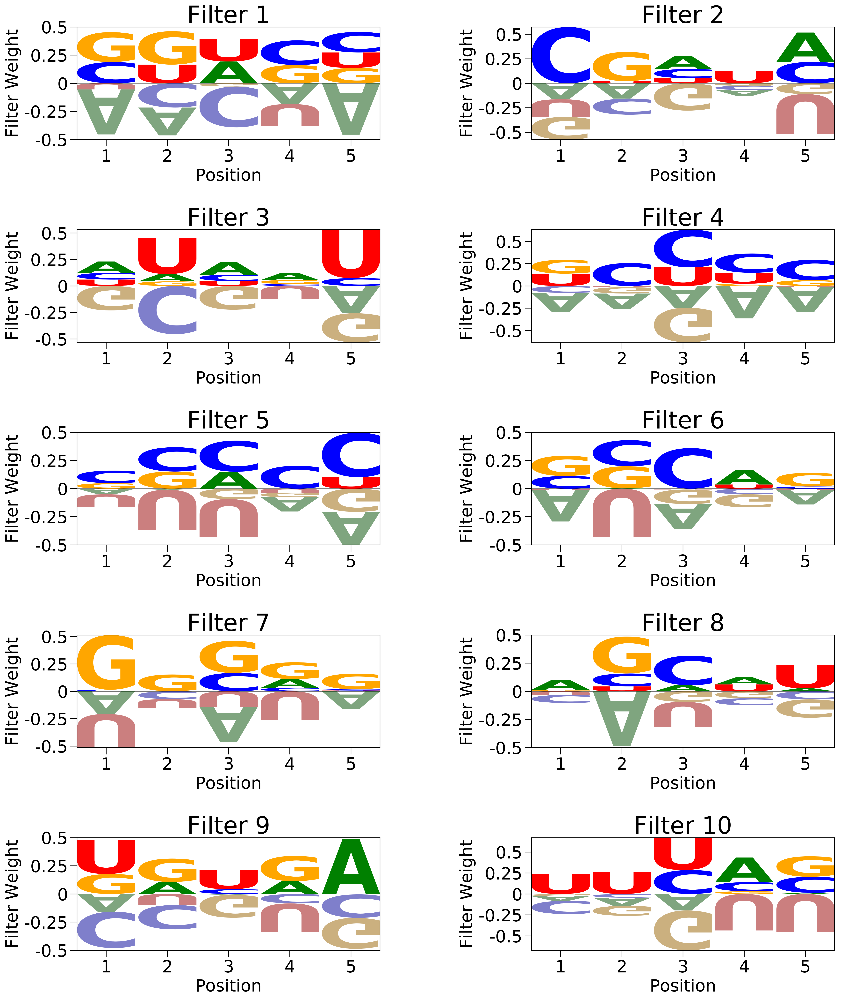

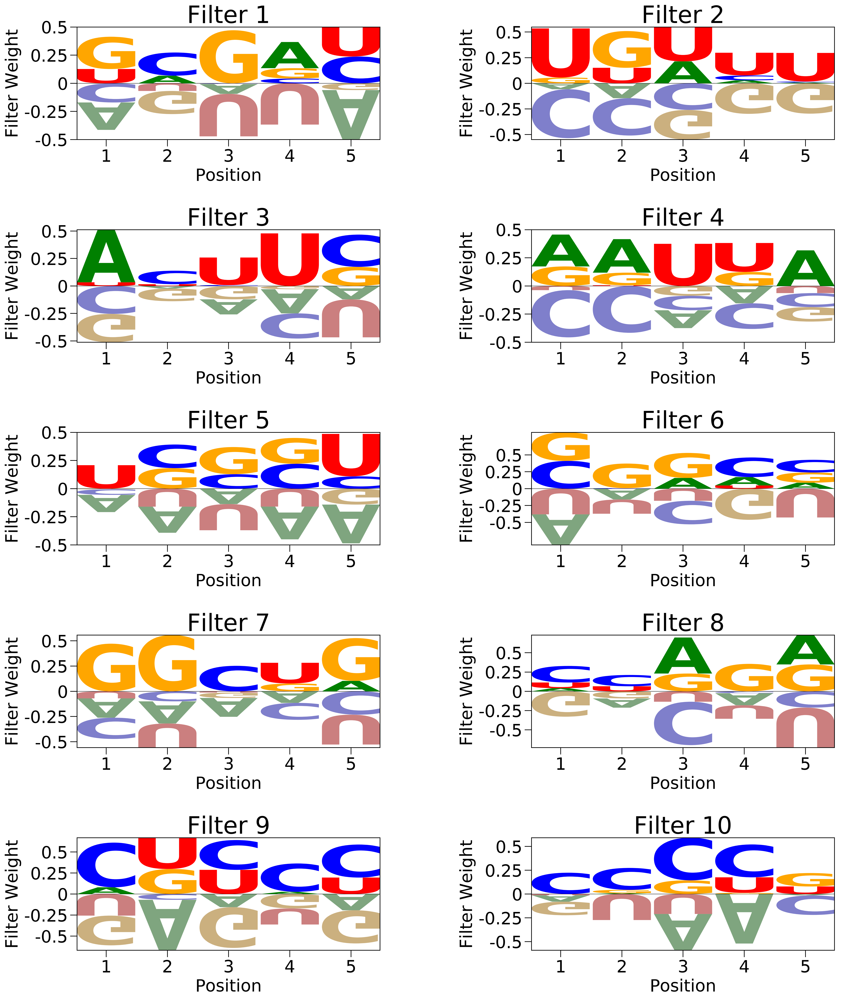

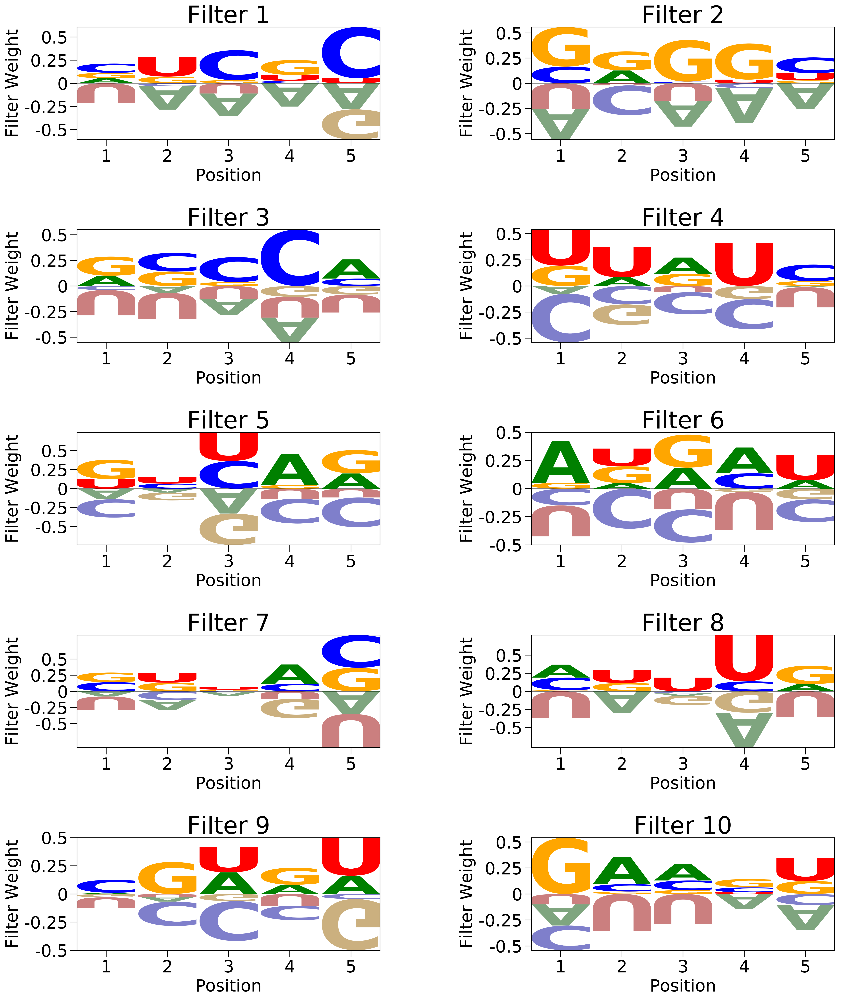

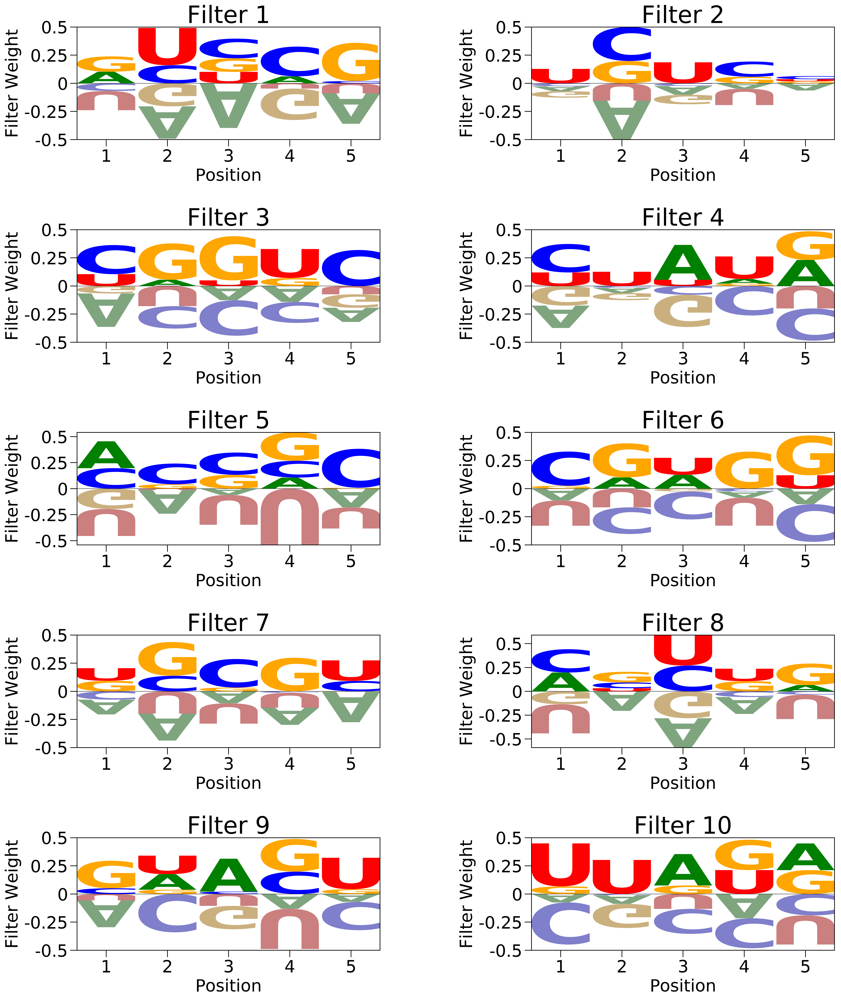

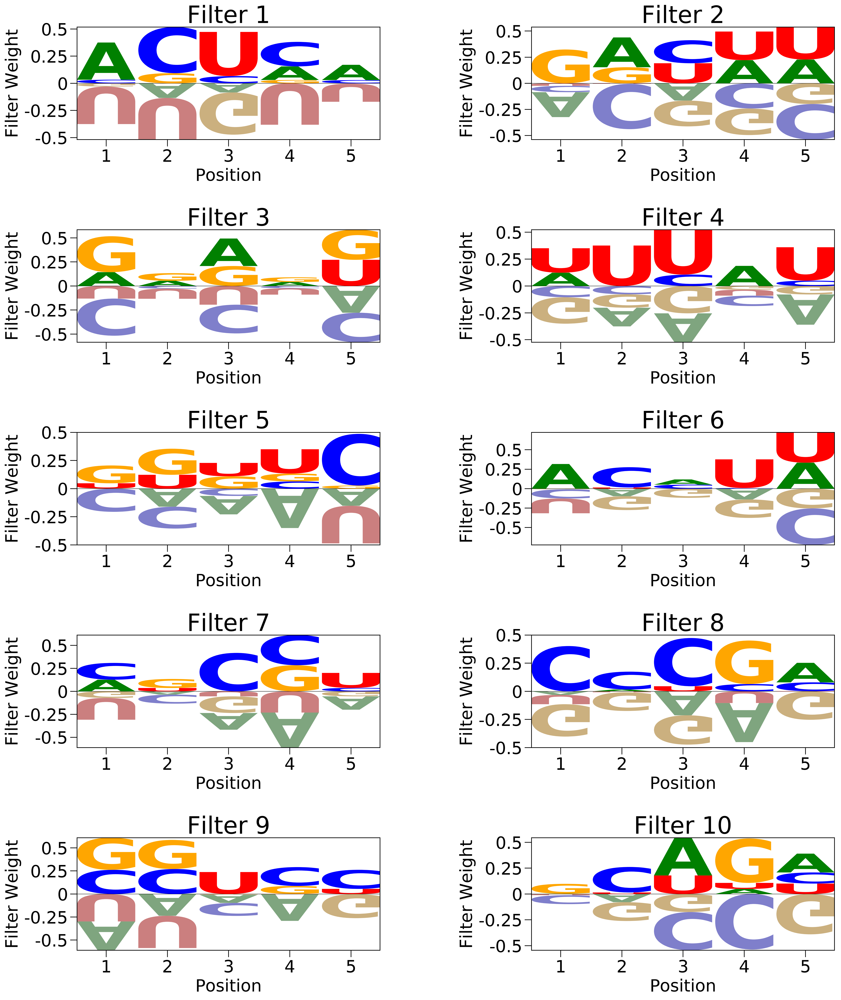

...

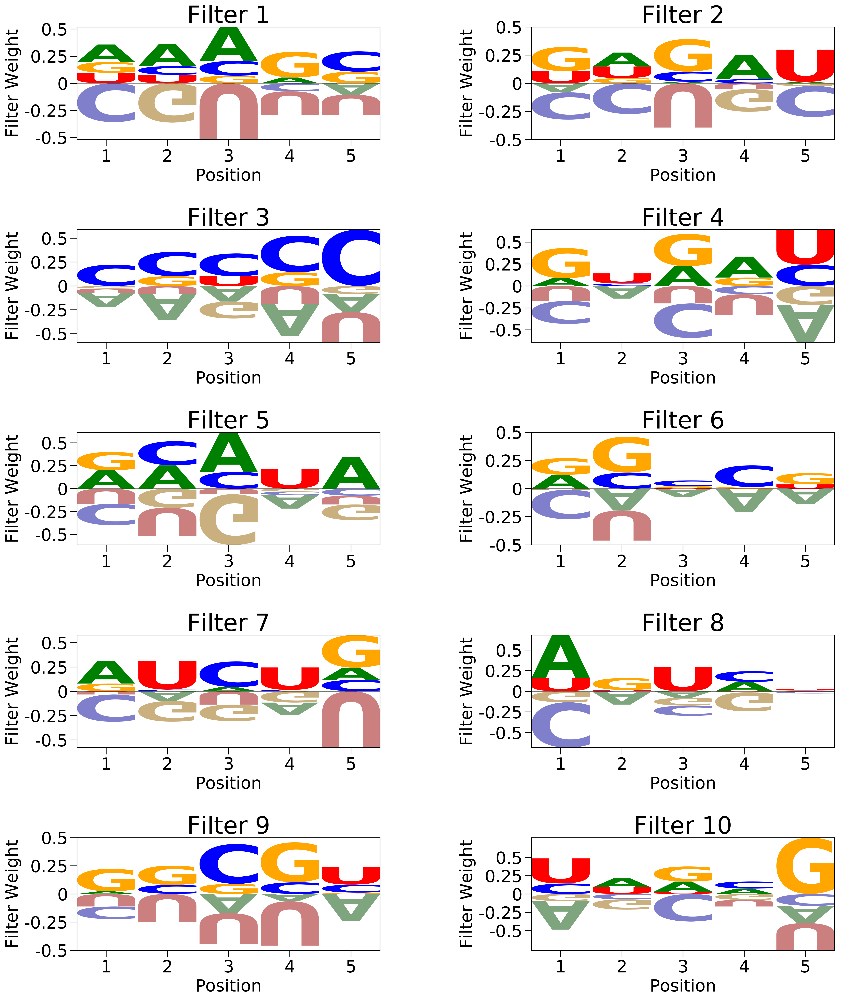

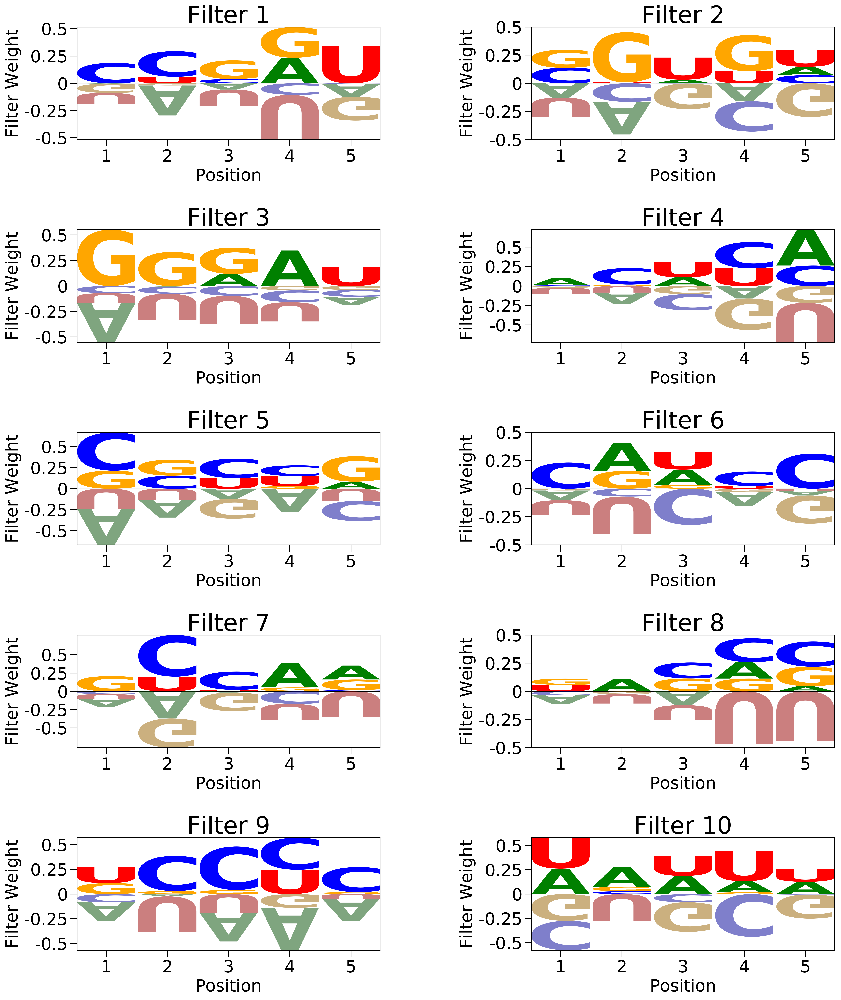

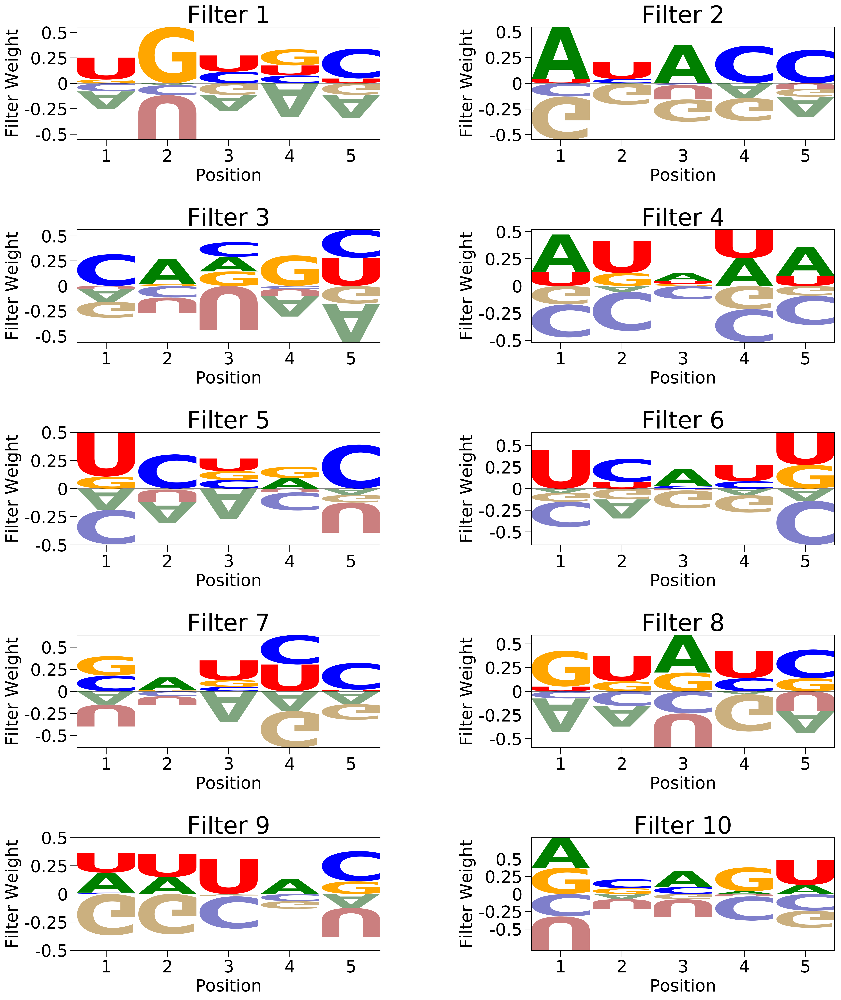

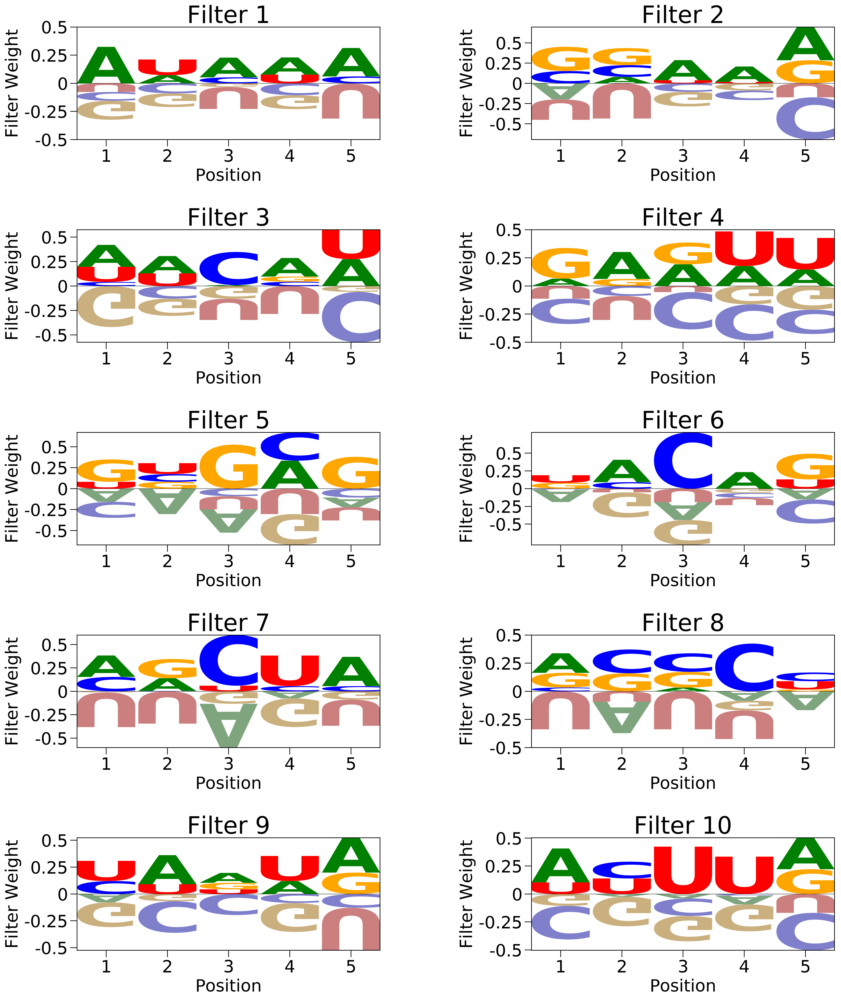

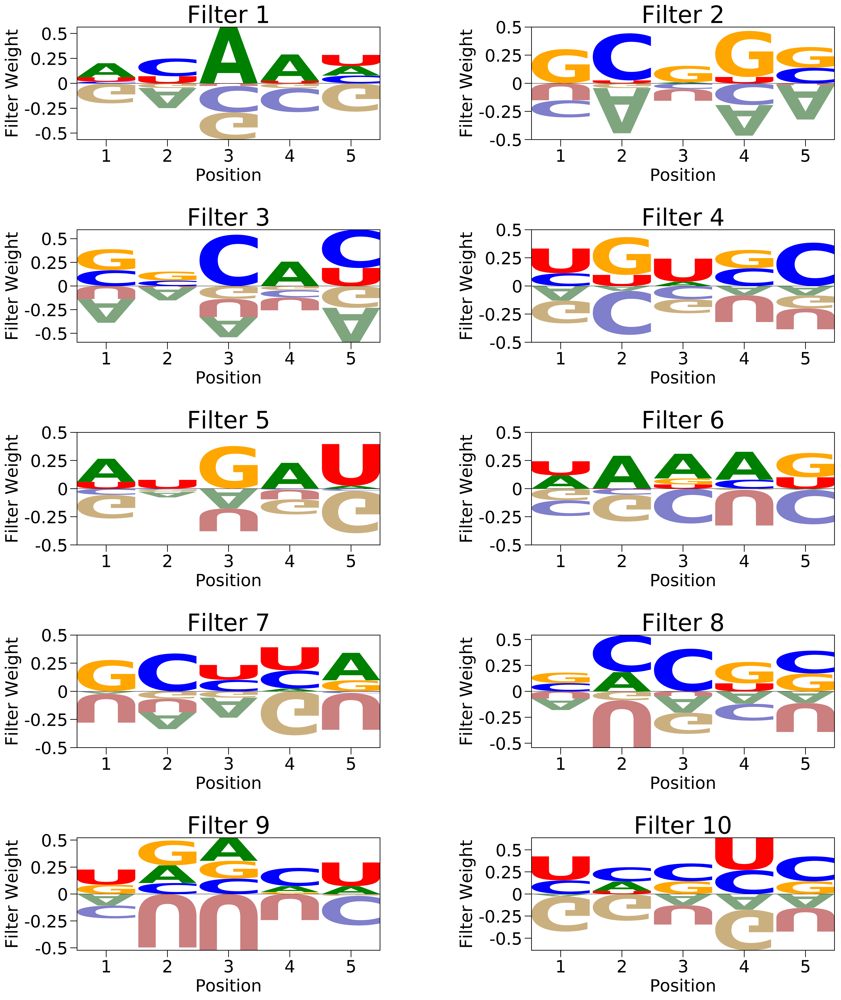

In [13]:
num_ensembl_models = 20

for i in range(0, num_ensembl_models):
    name = 'model_' + str(i)
    curr_model = train_one_model(name)
    analyze_filters_in_model(curr_model, name)